<a href="https://colab.research.google.com/github/laume/object_detection/blob/master/object_detection.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

![alt text](https://storage.googleapis.com/kaggle-datasets-images/119698/287851/df7f78af1d870a91a386e27d72e614cd/dataset-cover.jpg?t=2019-02-13-05-56-30)
# Stanford Dogs Dataset

Over 20,000 images of 120 dog breeds

https://www.kaggle.com/jessicali9530/stanford-dogs-dataset 

## Setup

In [2]:
from google.colab import drive
drive.mount('/content/gdrive', force_remount=True)

Mounted at /content/gdrive


In [0]:
SETUP = True
COMPETITION = 'kaggle datasets download -d jessicali9530/stanford-dogs-dataset'
DATA_DIR = 'data/dogs/'
TEMP_DIR = '/content/gdrive/My Drive/DL/'

In [3]:
import os

try:
    %tensorflow_version 2.x
    %matplotlib inline
except:
    %load_ext lab_black
    os.environ["CUDA_DEVICE_ORDER"] = "PCI_BUS_ID"
    os.environ["CUDA_VISIBLE_DEVICES"] = "0"

TensorFlow 2.x selected.


In [0]:
%matplotlib inline

In [5]:
if SETUP:
    !pip install -q -U dlai
    !pip install -q -U toai
    !pip install -q -U nb_black

    print(__import__("toai").__version__)
    print(f'dlai version: {__import__("dlai").__version__}, tf version: {__import__("tensorflow").__version__}')

     |████████████████████████████████| 153kB 7.5MB/s 
     |████████████████████████████████| 552kB 45.4MB/s 
     |████████████████████████████████| 296kB 46.7MB/s 
     |████████████████████████████████| 81kB 10.0MB/s 
     |████████████████████████████████| 61kB 9.6MB/s 
     |████████████████████████████████| 122kB 44.0MB/s 
ERROR: tensor2tensor 1.14.1 has requirement tensorflow-probability==0.7.0, but you'll have tensorflow-probability 0.9.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement google-auth~=1.4.0, but you'll have google-auth 1.11.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement requests~=2.21.0, but you'll have requests 2.22.0 which is incompatible.
ERROR: google-colab 1.0.0 has requirement six~=1.12.0, but you'll have six 1.14.0 which is incompatible.
ERROR: datascience 0.10.6 has requirement folium==0.2.1, but you'll have folium 0.8.3 which is incompatible.
     |████████████████████████████████| 102kB 3.5MB/s 
     |███████████████

In [6]:

import dlai
from dlai.imports import *
import tensorflow as tf
from tensorflow import keras
from toai.imports import *
from toai.image import ImageAugmentor, ImageParser, ImageResizer, ImageDataContainer
from toai.data.utils import split_df
from toai.encode import CategoricalEncoder
from typing import *
import tensorflow as tf
from tensorflow import keras
import tensorflow_datasets as tfds
import tensorflow_hub as hub
from glob import glob
from matplotlib.patches import Rectangle
from skimage.transform import resize

/usr/local/lib/python3.6/dist-packages/toai/imports.py:71: UserWarning: Could not find kaggle.json. Make sure it's located in /root/.kaggle. Or use the environment method.
  warnings.warn(str(error))


In [0]:
if SETUP:
    setup_kaggle()
    download_kaggle_data(COMPETITION, DATA_DIR)

In [8]:
!ls {DATA_DIR}

annotations  images


In [0]:
DATA_DIR = Path(DATA_DIR)

In [0]:
TEMP_DIR = Path(TEMP_DIR)

# Preprocess data

In [0]:
if SETUP:
    all_files = []
    for filename in glob(str(DATA_DIR / "images/Images/**/*.jpg"), recursive=True):
        try:
            img_id = filename.split('/')[-1].split('.')[0]
            category = filename.split('/')[-2] #.split('-')[-1]
            all_files.append({
                'filename': filename,
                'ids': img_id,
                'category': category
                })
        except:
            pass
    df = pd.DataFrame(all_files)

In [0]:
pd.set_option('display.max_colwidth', -1)

In [13]:
df['category'].nunique()

120

In [14]:
df.tail()

,filename,ids,category
20575,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_2966.jpg,n02093859_2966,n02093859-Kerry_blue_terrier
20576,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_82.jpg,n02093859_82,n02093859-Kerry_blue_terrier
20577,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_3153.jpg,n02093859_3153,n02093859-Kerry_blue_terrier
20578,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_3166.jpg,n02093859_3166,n02093859-Kerry_blue_terrier
20579,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_2293.jpg,n02093859_2293,n02093859-Kerry_blue_terrier


In [15]:
len(df)

20580

In [16]:
!cat {DATA_DIR}/'annotations/Annotation/n02086910-papillon/n02086910_7949'

<annotation>
	<folder>02086910</folder>
	<filename>n02086910_7949</filename>
	<source>
		<database>ImageNet database</database>
	</source>
	<size>
		<width>500</width>
		<height>400</height>
		<depth>3</depth>
	</size>
	<segment>0</segment>
	<object>
		<name>papillon</name>
		<pose>Unspecified</pose>
		<truncated>0</truncated>
		<difficult>0</difficult>
		<bndbox>
			<xmin>73</xmin>
			<ymin>23</ymin>
			<xmax>485</xmax>
			<ymax>399</ymax>
		</bndbox>
	</object>
</annotation>

In [0]:
import xml.etree.ElementTree as ET

def parse_xml(file_to_parse):
    tree = ET.parse(file_to_parse)
    root = tree.getroot()

    for child in root:
        if child.tag == 'filename':
            img_id = child.text

    for elem in root:
        for subelem in elem:
            if subelem.tag == 'width':
                w = subelem.text
            if subelem.tag == 'height':
                h = subelem.text
            if subelem.tag == 'depth':
                d = subelem.text

    for sb in subelem:
        if sb.tag == 'xmin':
            xmin = sb.text
        if sb.tag == 'ymin':
            ymin = sb.text
        if sb.tag == 'xmax':
            xmax = sb.text
        if sb.tag == 'ymax':
            ymax = sb.text  

    return img_id, w, h, d, xmin, ymin, xmax, ymax

In [0]:
if SETUP:
    rows_list = []
    for xml_filename in glob(str(DATA_DIR / "annotations/Annotation/**/*"), recursive=True):
        try:
            img_id, w, h, d, xmin, ymin, xmax, ymax = parse_xml(xml_filename)
            rows_list.append({
                'img_id': img_id, 
                'width': w, 
                'height': h, 
                'depth': d, 
                'xmin': xmin, 
                'ymin': ymin, 
                'xmax': xmax, 
                'ymax': ymax,
                })
        except:
            pass
    df_anno = pd.DataFrame(rows_list)

In [19]:
df_anno.head()

,img_id,width,height,depth,xmin,ymin,xmax,ymax
0,n02091244_873,581,525,3,42,3,548,514
1,n02091244_3552,400,300,3,112,101,239,256
2,n02091244_1371,500,375,3,177,117,361,277
3,n02091244_2760,500,420,3,286,102,428,152
4,n02091244_2820,250,286,3,21,1,249,285


In [20]:
df.category.nunique(), len(df_anno)

(120, 20580)

In [21]:
data = df.merge(df_anno, left_on='ids', right_on='img_id') #, how='left')
data.head()

,filename,ids,category,img_id,width,height,depth,xmin,ymin,xmax,ymax
0,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_873.jpg,n02091244_873,n02091244-Ibizan_hound,n02091244_873,581,525,3,42,3,548,514
1,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_716.jpg,n02091244_716,n02091244-Ibizan_hound,n02091244_716,325,367,3,13,17,294,365
2,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_25.jpg,n02091244_25,n02091244-Ibizan_hound,n02091244_25,295,447,3,0,3,273,445
3,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_596.jpg,n02091244_596,n02091244-Ibizan_hound,n02091244_596,500,397,3,58,125,361,382
4,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_5038.jpg,n02091244_5038,n02091244-Ibizan_hound,n02091244_5038,334,364,3,32,14,293,332


In [22]:
data.category.nunique(), len(data)

(116, 19956)

In [23]:
data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 19956 entries, 0 to 19955
Data columns (total 11 columns):
filename    19956 non-null object
ids         19956 non-null object
category    19956 non-null object
img_id      19956 non-null object
width       19956 non-null object
height      19956 non-null object
depth       19956 non-null object
xmin        19956 non-null object
ymin        19956 non-null object
xmax        19956 non-null object
ymax        19956 non-null object
dtypes: object(11)
memory usage: 1.8+ MB


In [0]:
data = data.astype({
    'width': 'int32', 
    'height': 'int32', 
    'depth': 'int32', 
    'xmin': 'int32', 
    'ymin': 'int32', 
    'xmax': 'int32', 
    'ymax': 'int32',
    })

In [25]:
data.dtypes

filename    object
ids         object
category    object
img_id      object
width       int32 
height      int32 
depth       int32 
xmin        int32 
ymin        int32 
xmax        int32 
ymax        int32 
dtype: object

In [26]:
data.describe().T

,count,mean,std,min,25%,50%,75%,max
width,19956.0,444.028212,141.484054,97.0,368.00,500.0,500.00,3264.0
height,19956.0,387.161756,123.579837,100.0,333.00,375.0,456.25,2560.0
depth,19956.0,3.000000,0.000000,3.0,3.00,3.0,3.00,3.0
xmin,19956.0,77.568601,77.029425,0.0,15.00,57.0,122.00,1230.0
ymin,19956.0,57.162457,59.571268,0.0,14.00,40.0,83.00,1548.0
xmax,19956.0,365.862748,129.200266,32.0,291.00,360.0,439.00,2735.0
ymax,19956.0,353.869062,122.052496,31.0,288.75,339.0,399.00,2457.0


## Checking and preparing the data

In [0]:
def get_image_dims(arr):
    heights, widths = [], []
    for filename in progress_bar(arr):
        height, width, _ = np.array(keras.preprocessing.image.load_img(filename)).shape
        heights.append(height)
        widths.append(width)
    return np.asarray(heights), np.asarray(widths)

In [28]:
data[["real_height", "real_width"]] = pd.DataFrame(get_image_dims(data["filename"])).T

In [29]:
data.head().T

,0,1,2,3,4
filename,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_873.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_716.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_25.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_596.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_5038.jpg
ids,n02091244_873,n02091244_716,n02091244_25,n02091244_596,n02091244_5038
category,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound
img_id,n02091244_873,n02091244_716,n02091244_25,n02091244_596,n02091244_5038
width,581,325,295,500,334
height,525,367,447,397,364
depth,3,3,3,3,3
xmin,42,13,0,58,32
ymin,3,17,3,125,14
xmax,548,294,273,361,293


In [0]:
data["xmin"] = data["xmin"] / data["width"]
data["xmax"] = data["xmax"] / data["width"]
data["ymin"] = data["ymin"] / data["height"]
data["ymax"] = data["ymax"] / data["height"]

In [31]:
data.head().T

,0,1,2,3,4
filename,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_873.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_716.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_25.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_596.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_5038.jpg
ids,n02091244_873,n02091244_716,n02091244_25,n02091244_596,n02091244_5038
category,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound
img_id,n02091244_873,n02091244_716,n02091244_25,n02091244_596,n02091244_5038
width,581,325,295,500,334
height,525,367,447,397,364
depth,3,3,3,3,3
xmin,0.0722892,0.04,0,0.116,0.0958084
ymin,0.00571429,0.0463215,0.00671141,0.314861,0.0384615
xmax,0.943201,0.904615,0.925424,0.722,0.877246


In [0]:
data["object_width"] = data["xmax"] - data["xmin"]
data["object_height"] = data["ymax"] - data["ymin"]

In [33]:
data.head().T

,0,1,2,3,4
filename,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_873.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_716.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_25.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_596.jpg,data/dogs/images/Images/n02091244-Ibizan_hound/n02091244_5038.jpg
ids,n02091244_873,n02091244_716,n02091244_25,n02091244_596,n02091244_5038
category,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound,n02091244-Ibizan_hound
img_id,n02091244_873,n02091244_716,n02091244_25,n02091244_596,n02091244_5038
width,581,325,295,500,334
height,525,367,447,397,364
depth,3,3,3,3,3
xmin,0.0722892,0.04,0,0.116,0.0958084
ymin,0.00571429,0.0463215,0.00671141,0.314861,0.0384615
xmax,0.943201,0.904615,0.925424,0.722,0.877246


In [34]:
data['category'].nunique()

116

In [0]:
category_map = {i: v for i, v in enumerate(data['category'].unique())}

In [36]:
category_map

{0: 'n02091244-Ibizan_hound',
 1: 'n02090379-redbone',
 2: 'n02099712-Labrador_retriever',
 3: 'n02115641-dingo',
 4: 'n02106550-Rottweiler',
 5: 'n02110063-malamute',
 6: 'n02102480-Sussex_spaniel',
 7: 'n02091032-Italian_greyhound',
 8: 'n02093991-Irish_terrier',
 9: 'n02107683-Bernese_mountain_dog',
 10: 'n02104029-kuvasz',
 11: 'n02112706-Brabancon_griffon',
 12: 'n02105412-kelpie',
 13: 'n02113799-standard_poodle',
 14: 'n02098413-Lhasa',
 15: 'n02104365-schipperke',
 16: 'n02099429-curly-coated_retriever',
 17: 'n02108551-Tibetan_mastiff',
 18: 'n02113023-Pembroke',
 19: 'n02090622-borzoi',
 20: 'n02096585-Boston_bull',
 21: 'n02100877-Irish_setter',
 22: 'n02113712-miniature_poodle',
 23: 'n02095889-Sealyham_terrier',
 24: 'n02100236-German_short-haired_pointer',
 25: 'n02110627-affenpinscher',
 26: 'n02093256-Staffordshire_bullterrier',
 27: 'n02101006-Gordon_setter',
 28: 'n02116738-African_hunting_dog',
 29: 'n02097658-silky_terrier',
 30: 'n02094433-Yorkshire_terrier',
 31: 

In [37]:
reversed_category_map = {v: i for i, v in enumerate(data['category'].unique())}
reversed_category_map

{'n02085620-Chihuahua': 104,
 'n02085782-Japanese_spaniel': 101,
 'n02085936-Maltese_dog': 108,
 'n02086079-Pekinese': 53,
 'n02086240-Shih-Tzu': 75,
 'n02086646-Blenheim_spaniel': 51,
 'n02086910-papillon': 60,
 'n02087046-toy_terrier': 41,
 'n02087394-Rhodesian_ridgeback': 95,
 'n02088094-Afghan_hound': 93,
 'n02088238-basset': 46,
 'n02088364-beagle': 113,
 'n02088466-bloodhound': 69,
 'n02088632-bluetick': 110,
 'n02089078-black-and-tan_coonhound': 49,
 'n02089867-Walker_hound': 35,
 'n02090379-redbone': 1,
 'n02090622-borzoi': 19,
 'n02090721-Irish_wolfhound': 99,
 'n02091032-Italian_greyhound': 7,
 'n02091134-whippet': 70,
 'n02091244-Ibizan_hound': 0,
 'n02091467-Norwegian_elkhound': 71,
 'n02091831-Saluki': 43,
 'n02092002-Scottish_deerhound': 54,
 'n02092339-Weimaraner': 61,
 'n02093256-Staffordshire_bullterrier': 26,
 'n02093428-American_Staffordshire_terrier': 72,
 'n02093647-Bedlington_terrier': 98,
 'n02093754-Border_terrier': 36,
 'n02093859-Kerry_blue_terrier': 115,
 'n0

In [0]:
for i, row in data.iterrows():
    data.at[i, 'category_id'] = reversed_category_map[row[2]]

In [39]:
data.tail().T

,19951,19952,19953,19954,19955
filename,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_2966.jpg,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_82.jpg,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_3153.jpg,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_3166.jpg,data/dogs/images/Images/n02093859-Kerry_blue_terrier/n02093859_2293.jpg
ids,n02093859_2966,n02093859_82,n02093859_3153,n02093859_3166,n02093859_2293
category,n02093859-Kerry_blue_terrier,n02093859-Kerry_blue_terrier,n02093859-Kerry_blue_terrier,n02093859-Kerry_blue_terrier,n02093859-Kerry_blue_terrier
img_id,n02093859_2966,n02093859_82,n02093859_3153,n02093859_3166,n02093859_2293
width,500,212,313,500,500
height,333,182,389,375,333
depth,3,3,3,3,3
xmin,0.414,0.0377358,0.0702875,0.486,0.358
ymin,0.18018,0.0769231,0.318766,0.152,0.042042
xmax,0.608,0.981132,0.961661,0.996,0.62


## Preparing the dataset

In [0]:
BATCH_SIZE = 32
SHUFFLE_SIZE = 1024
IMG_DIMS = (299, 299, 3)
N_IMAGES = data.shape[0]

In [0]:
train_data, validation_data, test_data = split_df(data, 0.2, "category_id")

In [0]:
train_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            train_data["filename"],
            tuple(
                [
                    train_data["category_id"].values,
                    train_data[["xmin", "ymin", "object_width", "object_height"]].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, "stretch"))
    .map(ImageAugmentor(level=3, rotate=False))
    .repeat()
    .shuffle(SHUFFLE_SIZE)
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
validation_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            validation_data["filename"],
            tuple(
                [
                    validation_data["category_id"].values,
                    validation_data[
                        ["xmin", "ymin", "object_width", "object_height"]
                    ].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, "stretch"))
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
test_set = (
    tf.data.Dataset.from_tensor_slices(
        (
            test_data["filename"],
            tuple(
                [
                    test_data["category_id"].values,
                    test_data[["xmin", "ymin", "object_width", "object_height"]].values,
                ]
            ),
        )
    )
    .map(ImageParser())
    .map(ImageResizer(IMG_DIMS, "stretch"))
    .batch(BATCH_SIZE)
    .prefetch(tf.data.experimental.AUTOTUNE)
)

In [0]:
def make_rectangle(x0, y0, width, height, img_dims, color, linewidth=2):
    return Rectangle(
        (x0 * img_dims[1], y0 * img_dims[0]),
        width * img_dims[1],
        height * img_dims[0],
        linewidth=linewidth,
        edgecolor=color,
        facecolor="none",
    )

In [0]:
def get_category_name(category_id: int, with_id: bool = False) -> str:
    return (
        f"{category_id} ({category_map[category_id]})"
        if with_id
        else category_map[category_id]
    )

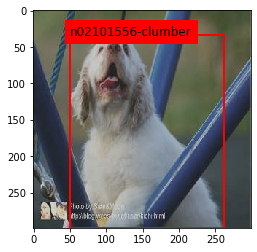

In [49]:
for x, y in train_set.take(1):
    n_image = 0
    categories, bounding_boxes = y
    category = categories[n_image].numpy()
    bounding_box = bounding_boxes[n_image].numpy()
    fig, ax = plt.subplots(1)
    ax.imshow(x[n_image].numpy())
    plt.text(
        bounding_box[0] * IMG_DIMS[0],
        bounding_box[1] * IMG_DIMS[1],
        get_category_name(category),
        backgroundcolor="red",
        fontsize=12,
    )
    y_rect = make_rectangle(*bounding_box, IMG_DIMS, "r")
    ax.add_patch(y_rect)
    plt.show()

In [0]:
n_categories = train_data["category"].nunique()

# Creating Xception model

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

In [0]:
def make_model():
    base = tf.keras.applications.Xception(
        input_shape=IMG_DIMS, include_top=False, weights="imagenet"
    )
    x = GlobalConcatPooling2D()(base.output)
    x = keras.layers.Dropout(0.4)(x)
    category = keras.layers.Dense(n_categories, activation=keras.activations.softmax)(x)
    bounding_box = keras.layers.Dense(4, activation=keras.activations.sigmoid)(x)
    model = keras.Model(inputs=base.input, outputs=[category, bounding_box])
    model.compile(
        loss=[
            keras.losses.SparseCategoricalCrossentropy(),
            keras.losses.BinaryCrossentropy(),
        ],
        loss_weights=[0.5, 2.0],
        optimizer=keras.optimizers.Adam(3e-4),
    )
    return model

In [73]:
model = make_model()

83689472/83683744 [==============================] - 2s 0us/step


In [80]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
block1_conv1 (Conv2D)           (None, 149, 149, 32) 864         input_1[0][0]                    
__________________________________________________________________________________________________
block1_conv1_bn (BatchNormaliza (None, 149, 149, 32) 128         block1_conv1[0][0]               
__________________________________________________________________________________________________
block1_conv1_act (Activation)   (None, 149, 149, 32) 0           block1_conv1_bn[0][0]            
______________________________________________________________________________________________

In [52]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=5,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR / "model1_dog_bbox.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True),
    ],
)

Train for 499 steps, validate for 63 steps
Epoch 1/5
499/499 [==============================] - 372s 746ms/step - loss: 1.6193 - dense_loss: 1.2740 - dense_1_loss: 0.4912 - val_loss: 1.2692 - val_dense_loss: 0.7208 - val_dense_1_loss: 0.4544
Epoch 2/5
499/499 [==============================] - 356s 713ms/step - loss: 1.1511 - dense_loss: 0.4739 - dense_1_loss: 0.4571 - val_loss: 1.2420 - val_dense_loss: 0.7023 - val_dense_1_loss: 0.4454
Epoch 3/5
499/499 [==============================] - 355s 711ms/step - loss: 1.0378 - dense_loss: 0.2884 - dense_1_loss: 0.4468 - val_loss: 1.2969 - val_dense_loss: 0.8201 - val_dense_1_loss: 0.4434
Epoch 4/5
499/499 [==============================] - 356s 713ms/step - loss: 0.9283 - dense_loss: 0.0962 - dense_1_loss: 0.4401 - val_loss: 1.1619 - val_dense_loss: 0.5718 - val_dense_1_loss: 0.4380
Epoch 5/5
499/499 [==============================] - 356s 714ms/step - loss: 0.8908 - dense_loss: 0.0346 - dense_1_loss: 0.4368 - val_loss: 1.1604 - val_dense_lo

In [0]:
# 1st run

# Train for 499 steps, validate for 63 steps
# Epoch 1/5
# 499/499 [==============================] - 380s 761ms/step - loss: 1.6220 - dense_loss: 1.2859 - dense_1_loss: 0.4895 - val_loss: 1.2682 - val_dense_loss: 0.7131 - val_dense_1_loss: 0.4558
# Epoch 2/5
# 499/499 [==============================] - 359s 720ms/step - loss: 1.1468 - dense_loss: 0.4672 - dense_1_loss: 0.4566 - val_loss: 1.2719 - val_dense_loss: 0.7401 - val_dense_1_loss: 0.4509
# Epoch 3/5
# 499/499 [==============================] - 360s 721ms/step - loss: 0.9627 - dense_loss: 0.1459 - dense_1_loss: 0.4449 - val_loss: 1.1507 - val_dense_loss: 0.5308 - val_dense_1_loss: 0.4427
# Epoch 4/5
# 499/499 [==============================] - 359s 720ms/step - loss: 0.9114 - dense_loss: 0.0646 - dense_1_loss: 0.4396 - val_loss: 1.1440 - val_dense_loss: 0.5262 - val_dense_1_loss: 0.4404
# Epoch 5/5
# 499/499 [==============================] - 359s 719ms/step - loss: 0.8943 - dense_loss: 0.0420 - dense_1_loss: 0.4366 - val_loss: 1.1564 - val_dense_loss: 0.5513 - val_dense_1_loss: 0.4403
# <tensorflow.python.keras.callbacks.History at 0x7f7a819d7dd8>

In [74]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=15,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR / "model1_dog_bbox_2.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=1),
        keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True),
    ],
)

Train for 499 steps, validate for 63 steps
Epoch 1/15
499/499 [==============================] - 370s 741ms/step - loss: 1.6099 - dense_2_loss: 1.2611 - dense_3_loss: 0.4897 - val_loss: 1.2505 - val_dense_2_loss: 0.6951 - val_dense_3_loss: 0.4515
Epoch 2/15
499/499 [==============================] - 355s 712ms/step - loss: 1.1470 - dense_2_loss: 0.4629 - dense_3_loss: 0.4578 - val_loss: 1.3147 - val_dense_2_loss: 0.8381 - val_dense_3_loss: 0.4478
Epoch 3/15
499/499 [==============================] - 356s 714ms/step - loss: 0.9681 - dense_2_loss: 0.1524 - dense_3_loss: 0.4459 - val_loss: 1.1316 - val_dense_2_loss: 0.5031 - val_dense_3_loss: 0.4400
Epoch 4/15
499/499 [==============================] - 355s 712ms/step - loss: 0.9141 - dense_2_loss: 0.0666 - dense_3_loss: 0.4404 - val_loss: 1.1362 - val_dense_2_loss: 0.5212 - val_dense_3_loss: 0.4378
Epoch 5/15
499/499 [==============================] - 355s 712ms/step - loss: 0.8912 - dense_2_loss: 0.0327 - dense_3_loss: 0.4374 - val_loss

KeyboardInterrupt: ignored

In [0]:
def predict(model, dataset, n_image=0):
    for x, y in dataset.take(1):
        fig, ax = plt.subplots(1)
        ax.imshow(x[n_image].numpy())

        p_categories, p_bounding_boxes = model.predict(x)
        p_category = p_categories[n_image].argmax()
        p_bounding_box = p_bounding_boxes[n_image]
        plt.text(
            (p_bounding_box[0] + p_bounding_box[2]) * IMG_DIMS[0] - 25,
            p_bounding_box[1] * IMG_DIMS[1],
            get_category_name(p_category),
            color="white",
            backgroundcolor="blue",
            fontsize=16,
        )
        p_rect = make_rectangle(*p_bounding_box, IMG_DIMS, "b", 3)
        ax.add_patch(p_rect)

        y_categories, y_bounding_boxes = y
        y_category = y_categories[n_image].numpy()
        y_bounding_box = y_bounding_boxes[n_image].numpy()
        plt.text(
            y_bounding_box[0] * IMG_DIMS[0] + 5,
            y_bounding_box[1] * IMG_DIMS[1],
            get_category_name(y_category),
            backgroundcolor="red",
            fontsize=16,
        )
        y_rect = make_rectangle(*y_bounding_box, IMG_DIMS, "r")
        ax.add_patch(y_rect)

        plt.show()

### Predicting after 5 epochs

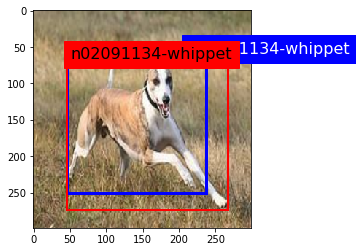

In [56]:
predict(model, validation_set, 8)

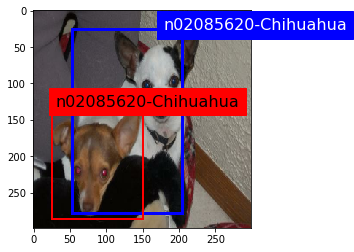

In [88]:
predict(model, validation_set, 10)

### Predictions after 15 epochs trainig

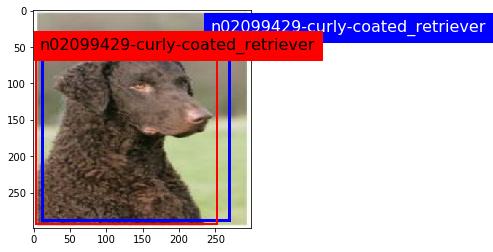

In [75]:
predict(model, validation_set, 18)

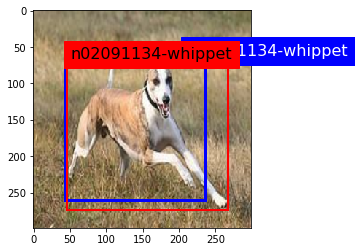

In [76]:
predict(model, validation_set, 8)

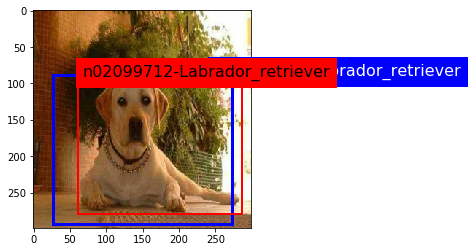

In [77]:
predict(model, validation_set, 10)

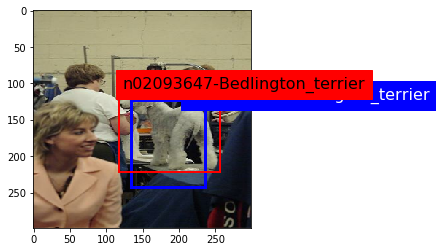

In [78]:
predict(model, validation_set, 13)

### Plot activations

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, (labels, _) = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs, _ = model.predict(images)
    predictions = class_probs.argmax(-1)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-2].get_weights()[0][:, prediction]
        weights1 = weights[..., :2048]
        weights2 = weights[..., 2048:]
        weights = weights1 + weights2
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy()))

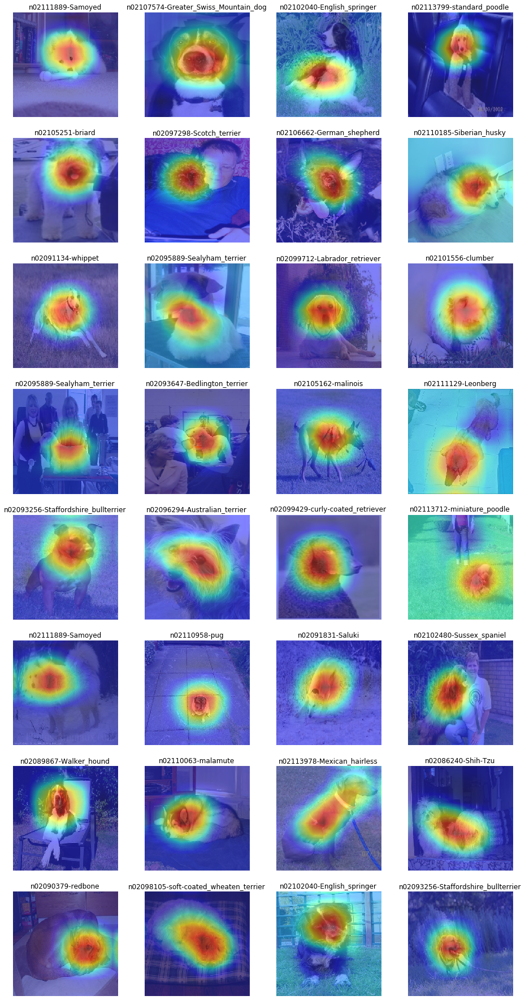

In [97]:
# global_average_pooling + global_max_pooling
show_activation_maps(model, validation_set, "block14_sepconv2_act")

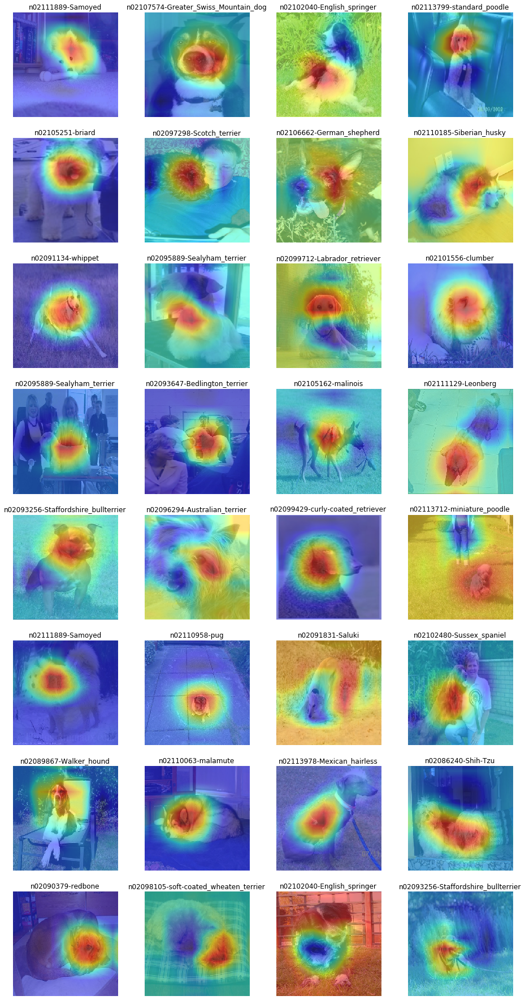

In [93]:
# with global_average_pooling weights
show_activation_maps(model, validation_set, "block14_sepconv2_act")

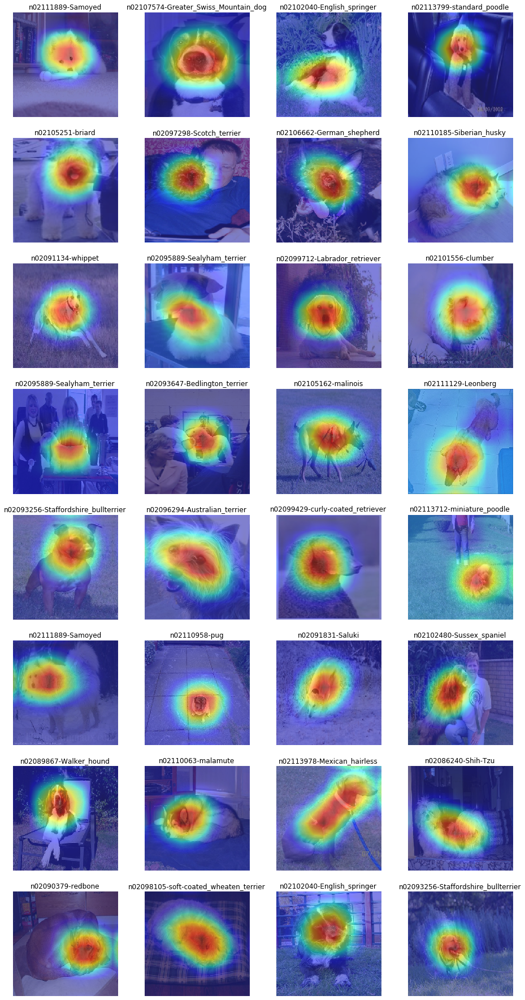

In [95]:
# with global_max_pooling weights
show_activation_maps(model, validation_set, "block14_sepconv2_act")

In [0]:
def make_report(model, dataset):
    print(
        classification_report(
            [category.numpy() for _, (category, _) in dataset.unbatch()],
            model.predict(dataset)[0].argmax(axis=1),
            target_names=list(category_map.values()),
        )
    )

In [90]:
# After 15 epochs:
make_report(model, validation_set)

                                          precision    recall  f1-score   support

                  n02091244-Ibizan_hound       1.00      0.84      0.91        19
                       n02090379-redbone       0.67      0.80      0.73        15
            n02099712-Labrador_retriever       0.88      0.82      0.85        17
                         n02115641-dingo       0.82      0.93      0.87        15
                    n02106550-Rottweiler       0.88      1.00      0.94        15
                      n02110063-malamute       0.75      0.67      0.71        18
                n02102480-Sussex_spaniel       0.87      0.87      0.87        15
             n02091032-Italian_greyhound       0.84      0.89      0.86        18
                 n02093991-Irish_terrier       0.88      0.88      0.88        17
          n02107683-Bernese_mountain_dog       0.92      1.00      0.96        22
                        n02104029-kuvasz       1.00      0.87      0.93        15
             n0

In [0]:
# 1st run validation report after 5 epochs

#                                          precision    recall  f1-score   support

#                   n02111277-Newfoundland       0.85      0.89      0.87        19
#             n02092002-Scottish_deerhound       1.00      0.83      0.90        23
#                      n02085620-Chihuahua       1.00      0.60      0.75        15
#                n02094114-Norfolk_terrier       0.85      0.65      0.73        17
#                n02090721-Irish_wolfhound       0.81      1.00      0.90        22
#         n02099429-curly-coated_retriever       1.00      0.73      0.85        15
#            n02087394-Rhodesian_ridgeback       0.79      0.88      0.83        17
#     n02107574-Greater_Swiss_Mountain_dog       0.93      0.82      0.87        17
#                 n02110185-Siberian_husky       0.50      0.89      0.64        19
#               n02099601-golden_retriever       0.74      0.93      0.82        15
#                    n02096585-Boston_bull       1.00      1.00      1.00        18
#              n02091032-Italian_greyhound       0.89      0.89      0.89        18
#               n02102040-English_springer       0.94      0.94      0.94        16
#                  n02101006-Gordon_setter       1.00      0.93      0.97        15
#                   n02108422-bull_mastiff       0.80      0.75      0.77        16
#    n02098286-West_Highland_white_terrier       0.68      1.00      0.81        17
#                 n02100735-English_setter       0.94      0.94      0.94        16
#                n02094258-Norwich_terrier       0.80      0.84      0.82        19
#             n02107312-miniature_pinscher       0.76      0.89      0.82        18
#                     n02092339-Weimaraner       0.94      1.00      0.97        16
#                        n02091134-whippet       1.00      0.79      0.88        19
#         n02102177-Welsh_springer_spaniel       1.00      0.93      0.97        15
#                n02113799-standard_poodle       0.70      0.88      0.78        16
#                   n02089867-Walker_hound       0.82      0.93      0.87        15
#                       n02105505-komondor       1.00      0.94      0.97        16
#                         n02100583-vizsla       1.00      0.94      0.97        16
#                    n02085936-Maltese_dog       1.00      0.88      0.94        25
#             n02093647-Bedlington_terrier       0.95      1.00      0.97        18
#                       n02086910-papillon       0.95      0.95      0.95        19
#                     n02112018-Pomeranian       0.96      1.00      0.98        22
#                    n02105056-groenendael       0.81      0.87      0.84        15
#                       n02086240-Shih-Tzu       0.74      0.77      0.76        22
#                    n02108000-EntleBucher       0.82      0.86      0.84        21
#                       n02088632-bluetick       0.89      0.94      0.91        17
#                         n02105412-kelpie       0.88      0.93      0.90        15
#                       n02105162-malinois       0.92      0.73      0.81        15
#             n02093859-Kerry_blue_terrier       0.85      0.94      0.89        18
#       n02099849-Chesapeake_Bay_retriever       0.80      0.94      0.86        17
#               n02086646-Blenheim_spaniel       1.00      0.89      0.94        19
#                       n02113186-Cardigan       0.87      0.81      0.84        16
#                       n02111129-Leonberg       0.87      0.95      0.91        21
#               n02113712-miniature_poodle       0.57      0.50      0.53        16
#          n02099267-flat-coated_retriever       1.00      1.00      1.00        15
#            n02116738-African_hunting_dog       1.00      1.00      1.00        17
#                         n02091831-Saluki       0.94      0.85      0.89        20
#            n02097047-miniature_schnauzer       0.86      0.80      0.83        15
#                       n02113023-Pembroke       0.85      0.94      0.89        18
#      n02093256-Staffordshire_bullterrier       0.52      0.69      0.59        16
#                     n02109961-Eskimo_dog       0.33      0.07      0.11        15
#                            n02110958-pug       0.95      0.95      0.95        20
#           n02107683-Bernese_mountain_dog       0.90      0.86      0.88        22
#                       n02086079-Pekinese       0.93      0.87      0.90        15
#                    n02087046-toy_terrier       0.79      0.65      0.71        17
#        n02095314-wire-haired_fox_terrier       0.91      0.67      0.77        15
#                n02097474-Tibetan_terrier       0.68      0.85      0.76        20
#               n02095889-Sealyham_terrier       0.95      0.90      0.92        20
#                  n02110627-affenpinscher       0.88      0.93      0.90        15
#                n02108551-Tibetan_mastiff       0.92      0.80      0.86        15
#                       n02096051-Airedale       0.95      0.90      0.92        20
#                         n02104029-kuvasz       0.67      0.93      0.78        15
#                   n02088094-Afghan_hound       0.92      1.00      0.96        24
#            n02102973-Irish_water_spaniel       0.75      0.80      0.77        15
#                  n02097658-silky_terrier       0.80      0.84      0.82        19
#                       n02107142-Doberman       0.83      1.00      0.91        15
#                  n02109525-Saint_Bernard       1.00      0.94      0.97        17
#                   n02100877-Irish_setter       0.93      0.81      0.87        16
#                 n02093754-Border_terrier       1.00      1.00      1.00        17
#                n02106662-German_shepherd       0.93      0.93      0.93        15
#                        n02101556-clumber       1.00      0.93      0.97        15
#                       n02112350-keeshond       1.00      1.00      1.00        16
#                    n02107908-Appenzeller       0.75      0.80      0.77        15
#                        n02110806-basenji       0.90      0.90      0.90        21
#                 n02097298-Scotch_terrier       0.88      0.94      0.91        16
#                          n02115913-dhole       0.88      1.00      0.94        15
# n02093428-American_Staffordshire_terrier       0.64      0.53      0.58        17
#                          n02108089-boxer       0.92      0.80      0.86        15
#                 n02096437-Dandie_Dinmont       1.00      0.94      0.97        18
#               n02113978-Mexican_hairless       1.00      0.94      0.97        16
#              n02094433-Yorkshire_terrier       0.75      0.75      0.75        16
#                     n02106550-Rottweiler       0.92      0.80      0.86        15
#           n02105641-Old_English_sheepdog       1.00      0.71      0.83        17
#                     n02088466-bloodhound       1.00      0.95      0.97        19
#               n02095570-Lakeland_terrier       0.69      0.95      0.80        19
#             n02099712-Labrador_retriever       0.71      0.88      0.79        17
#                        n02111889-Samoyed       0.80      0.91      0.85        22
#        n02089078-black-and-tan_coonhound       0.89      1.00      0.94        16
#               n02101388-Brittany_spaniel       0.93      0.93      0.93        15
#              n02112706-Brabancon_griffon       0.86      0.80      0.83        15
#                          n02115641-dingo       0.67      0.62      0.65        16
#                 n02102480-Sussex_spaniel       1.00      0.87      0.93        15
#                       n02110063-malamute       0.86      0.67      0.75        18
#                n02097130-giant_schnauzer       0.71      0.75      0.73        16
#                         n02090622-borzoi       0.69      0.73      0.71        15
#                         n02088364-beagle       0.88      0.79      0.83        19
#                   n02091244-Ibizan_hound       0.95      0.95      0.95        19
#                 n02102318-cocker_spaniel       0.72      0.81      0.76        16
#             n02096294-Australian_terrier       0.83      0.79      0.81        19
#                         n02088238-basset       0.94      1.00      0.97        17
#                         n02106030-collie       0.92      0.75      0.83        16
#                     n02104365-schipperke       0.80      0.80      0.80        15
#           n02106382-Bouvier_des_Flandres       0.81      0.87      0.84        15
#             n02091467-Norwegian_elkhound       0.95      0.95      0.95        20
#                  n02093991-Irish_terrier       0.93      0.82      0.87        17
#                     n02113624-toy_poodle       0.69      0.60      0.64        15
#               n02085782-Japanese_spaniel       0.95      0.95      0.95        19
#                  n02106166-Border_collie       0.86      0.80      0.83        15
#                         n02105251-briard       0.88      1.00      0.94        15
#             n02097209-standard_schnauzer       0.81      0.87      0.84        15
#                          n02098413-Lhasa       0.58      0.39      0.47        18
#                 n02111500-Great_Pyrenees       0.77      0.77      0.77        22
#                        n02090379-redbone       0.86      0.80      0.83        15
#                     n02109047-Great_Dane       0.81      0.87      0.84        15
#                          n02096177-cairn       0.78      0.90      0.84        20
#    n02100236-German_short-haired_pointer       1.00      0.80      0.89        15
#                           n02112137-chow       1.00      0.90      0.95        20
#    n02098105-soft-coated_wheaten_terrier       0.93      0.87      0.90        15

#                                 accuracy                           0.86      1996
#                                macro avg       0.86      0.85      0.85      1996
#                             weighted avg       0.86      0.86      0.85      1996


In [91]:
make_report(model, test_set)

                                          precision    recall  f1-score   support

                  n02091244-Ibizan_hound       0.82      0.95      0.88        19
                       n02090379-redbone       0.79      1.00      0.88        15
            n02099712-Labrador_retriever       0.78      0.82      0.80        17
                         n02115641-dingo       0.93      0.88      0.90        16
                    n02106550-Rottweiler       0.78      0.93      0.85        15
                      n02110063-malamute       0.75      0.83      0.79        18
                n02102480-Sussex_spaniel       1.00      0.93      0.97        15
             n02091032-Italian_greyhound       0.94      0.83      0.88        18
                 n02093991-Irish_terrier       0.88      0.82      0.85        17
          n02107683-Bernese_mountain_dog       0.95      0.95      0.95        22
                        n02104029-kuvasz       0.71      0.80      0.75        15
             n0

In [0]:
# 1st run test report

#                                          precision    recall  f1-score   support

#                   n02111277-Newfoundland       0.83      1.00      0.91        20
#             n02092002-Scottish_deerhound       0.92      0.92      0.92        24
#                      n02085620-Chihuahua       0.92      0.80      0.86        15
#                n02094114-Norfolk_terrier       0.92      0.71      0.80        17
#                n02090721-Irish_wolfhound       0.83      0.86      0.84        22
#         n02099429-curly-coated_retriever       0.92      0.80      0.86        15
#            n02087394-Rhodesian_ridgeback       0.67      0.82      0.74        17
#     n02107574-Greater_Swiss_Mountain_dog       0.89      0.94      0.91        17
#                 n02110185-Siberian_husky       0.50      0.79      0.61        19
#               n02099601-golden_retriever       0.87      0.87      0.87        15
#                    n02096585-Boston_bull       0.90      1.00      0.95        18
#              n02091032-Italian_greyhound       0.70      0.89      0.78        18
#               n02102040-English_springer       1.00      0.69      0.81        16
#                  n02101006-Gordon_setter       0.93      0.88      0.90        16
#                   n02108422-bull_mastiff       0.93      0.87      0.90        15
#    n02098286-West_Highland_white_terrier       0.71      0.88      0.79        17
#                 n02100735-English_setter       0.83      0.62      0.71        16
#                n02094258-Norwich_terrier       0.74      0.78      0.76        18
#             n02107312-miniature_pinscher       0.80      0.84      0.82        19
#                     n02092339-Weimaraner       1.00      1.00      1.00        16
#                        n02091134-whippet       0.60      0.67      0.63        18
#         n02102177-Welsh_springer_spaniel       0.88      0.93      0.90        15
#                n02113799-standard_poodle       0.86      0.75      0.80        16
#                   n02089867-Walker_hound       0.90      0.56      0.69        16
#                       n02105505-komondor       0.93      0.87      0.90        15
#                         n02100583-vizsla       0.94      1.00      0.97        15
#                    n02085936-Maltese_dog       0.85      0.88      0.87        26
#             n02093647-Bedlington_terrier       1.00      1.00      1.00        18
#                       n02086910-papillon       0.95      0.95      0.95        20
#                     n02112018-Pomeranian       0.92      1.00      0.96        22
#                    n02105056-groenendael       1.00      0.93      0.97        15
#                       n02086240-Shih-Tzu       0.85      0.81      0.83        21
#                    n02108000-EntleBucher       1.00      1.00      1.00        20
#                       n02088632-bluetick       0.94      0.88      0.91        17
#                         n02105412-kelpie       0.83      0.94      0.88        16
#                       n02105162-malinois       1.00      0.80      0.89        15
#             n02093859-Kerry_blue_terrier       0.94      0.89      0.91        18
#       n02099849-Chesapeake_Bay_retriever       0.75      0.94      0.83        16
#               n02086646-Blenheim_spaniel       0.90      0.95      0.92        19
#                       n02113186-Cardigan       1.00      0.93      0.97        15
#                       n02111129-Leonberg       1.00      0.95      0.98        21
#               n02113712-miniature_poodle       0.50      0.53      0.52        15
#          n02099267-flat-coated_retriever       0.93      0.93      0.93        15
#            n02116738-African_hunting_dog       1.00      1.00      1.00        17
#                         n02091831-Saluki       0.95      0.95      0.95        20
#            n02097047-miniature_schnauzer       0.88      0.88      0.88        16
#                       n02113023-Pembroke       0.95      1.00      0.97        18
#      n02093256-Staffordshire_bullterrier       0.77      0.67      0.71        15
#                     n02109961-Eskimo_dog       0.44      0.27      0.33        15
#                            n02110958-pug       0.95      1.00      0.98        20
#           n02107683-Bernese_mountain_dog       0.81      1.00      0.90        22
#                       n02086079-Pekinese       1.00      1.00      1.00        15
#                    n02087046-toy_terrier       0.83      0.59      0.69        17
#        n02095314-wire-haired_fox_terrier       0.92      0.69      0.79        16
#                n02097474-Tibetan_terrier       0.86      0.86      0.86        21
#               n02095889-Sealyham_terrier       0.91      0.95      0.93        21
#                  n02110627-affenpinscher       0.78      0.93      0.85        15
#                n02108551-Tibetan_mastiff       1.00      0.73      0.85        15
#                       n02096051-Airedale       0.95      0.95      0.95        21
#                         n02104029-kuvasz       0.77      0.67      0.71        15
#                   n02088094-Afghan_hound       1.00      1.00      1.00        24
#            n02102973-Irish_water_spaniel       1.00      0.80      0.89        15
#                  n02097658-silky_terrier       0.73      0.89      0.80        18
#                       n02107142-Doberman       0.88      0.93      0.90        15
#                  n02109525-Saint_Bernard       0.94      0.94      0.94        17
#                   n02100877-Irish_setter       0.88      0.93      0.90        15
#                 n02093754-Border_terrier       1.00      0.88      0.94        17
#                n02106662-German_shepherd       0.93      0.93      0.93        15
#                        n02101556-clumber       0.94      1.00      0.97        15
#                       n02112350-keeshond       1.00      1.00      1.00        16
#                    n02107908-Appenzeller       0.93      0.87      0.90        15
#                        n02110806-basenji       0.89      0.81      0.85        21
#                 n02097298-Scotch_terrier       0.88      0.88      0.88        16
#                          n02115913-dhole       1.00      0.93      0.97        15
# n02093428-American_Staffordshire_terrier       0.67      0.62      0.65        16
#                          n02108089-boxer       1.00      0.87      0.93        15
#                 n02096437-Dandie_Dinmont       1.00      0.94      0.97        18
#               n02113978-Mexican_hairless       1.00      1.00      1.00        15
#              n02094433-Yorkshire_terrier       0.75      0.88      0.81        17
#                     n02106550-Rottweiler       0.94      1.00      0.97        15
#           n02105641-Old_English_sheepdog       1.00      0.88      0.94        17
#                     n02088466-bloodhound       1.00      0.89      0.94        18
#               n02095570-Lakeland_terrier       0.76      0.80      0.78        20
#             n02099712-Labrador_retriever       0.83      0.88      0.86        17
#                        n02111889-Samoyed       0.88      1.00      0.94        22
#        n02089078-black-and-tan_coonhound       0.83      0.94      0.88        16
#               n02101388-Brittany_spaniel       0.78      0.93      0.85        15
#              n02112706-Brabancon_griffon       1.00      1.00      1.00        16
#                          n02115641-dingo       0.88      0.93      0.90        15
#                 n02102480-Sussex_spaniel       1.00      0.80      0.89        15
#                       n02110063-malamute       0.75      0.67      0.71        18
#                n02097130-giant_schnauzer       0.78      0.93      0.85        15
#                         n02090622-borzoi       0.75      1.00      0.86        15
#                         n02088364-beagle       0.75      0.75      0.75        20
#                   n02091244-Ibizan_hound       0.89      0.89      0.89        19
#                 n02102318-cocker_spaniel       0.82      0.88      0.85        16
#             n02096294-Australian_terrier       0.89      0.80      0.84        20
#                         n02088238-basset       0.77      0.94      0.85        18
#                         n02106030-collie       0.78      0.47      0.58        15
#                     n02104365-schipperke       0.88      0.94      0.91        16
#           n02106382-Bouvier_des_Flandres       0.78      0.47      0.58        15
#             n02091467-Norwegian_elkhound       1.00      0.89      0.94        19
#                  n02093991-Irish_terrier       0.84      0.94      0.89        17
#                     n02113624-toy_poodle       0.62      0.67      0.65        15
#               n02085782-Japanese_spaniel       0.89      0.94      0.92        18
#                  n02106166-Border_collie       0.53      0.67      0.59        15
#                         n02105251-briard       0.78      0.93      0.85        15
#             n02097209-standard_schnauzer       0.86      0.75      0.80        16
#                          n02098413-Lhasa       0.82      0.74      0.78        19
#                 n02111500-Great_Pyrenees       0.90      0.86      0.88        21
#                        n02090379-redbone       0.88      1.00      0.94        15
#                     n02109047-Great_Dane       0.79      0.69      0.73        16
#                          n02096177-cairn       0.88      0.79      0.83        19
#    n02100236-German_short-haired_pointer       0.85      0.73      0.79        15
#                           n02112137-chow       1.00      1.00      1.00        19
#    n02098105-soft-coated_wheaten_terrier       0.88      0.88      0.88        16

#                                 accuracy                           0.86      1996
#                                macro avg       0.87      0.86      0.86      1996
#                             weighted avg       0.87      0.86      0.86      1996

In [0]:
def analyse_dataset(model, dataset, verbose: int = 0):
    images = [x.numpy() for x, _ in dataset.unbatch()]
    probs = model.predict(dataset)[0]
    pred_code = probs.argmax(axis=1)
    label_code = [int(category.numpy()) for _, (category, _) in dataset.unbatch()]
    print(label_code)
    return pd.DataFrame.from_dict(
        {
            "image": images,
            "label": label_code,
            "pred": pred_code,
            "label_probs": probs[:, label_code][np.eye(len(label_code), dtype=bool)],
            "pred_probs": probs[:, pred_code][np.eye(len(pred_code), dtype=bool)],
        }
    )

In [61]:
analyse_dataset(model, validation_set)

[111, 82, 50, 13, 103, 56, 65, 114, 70, 23, 2, 96, 23, 98, 31, 94, 26, 40, 16, 22, 111, 112, 43, 6, 35, 5, 88, 75, 1, 66, 50, 26, 87, 103, 57, 100, 38, 34, 93, 72, 19, 91, 9, 98, 90, 99, 69, 94, 25, 80, 76, 66, 17, 54, 32, 36, 29, 111, 31, 15, 113, 43, 112, 18, 74, 0, 110, 65, 54, 16, 61, 103, 7, 42, 58, 111, 59, 1, 90, 98, 79, 110, 28, 81, 73, 104, 67, 63, 7, 108, 10, 78, 37, 111, 84, 65, 59, 72, 111, 17, 43, 78, 83, 108, 57, 47, 73, 61, 20, 111, 15, 98, 65, 82, 23, 94, 32, 114, 32, 42, 109, 92, 43, 4, 71, 51, 68, 82, 42, 111, 72, 19, 81, 111, 7, 109, 85, 20, 0, 19, 4, 54, 108, 7, 108, 58, 59, 35, 67, 14, 23, 46, 19, 41, 0, 49, 60, 65, 73, 36, 24, 76, 29, 89, 94, 5, 48, 10, 111, 39, 21, 21, 25, 53, 9, 75, 52, 107, 93, 87, 38, 36, 35, 49, 101, 114, 2, 93, 35, 70, 70, 1, 98, 24, 59, 95, 48, 20, 60, 64, 63, 41, 81, 46, 48, 20, 2, 59, 111, 8, 55, 2, 4, 84, 21, 26, 33, 36, 47, 31, 29, 62, 82, 74, 38, 28, 20, 45, 95, 100, 58, 55, 62, 9, 106, 60, 40, 46, 94, 88, 69, 0, 54, 69, 97, 102, 8, 10

image  ...  pred_probs
0     [[[0.42027378, 0.38497967, 0.3261561], [0.42402783, 0.3887337, 0.32991016], [0.42436704, 0.38907292, 0.33024937], [0.4279494, 0.39265528, 0.33383173], [0.42834944, 0.39305532, 0.33423176], [0.4269133, 0.39161918, 0.33279562], [0.43187097, 0.39657685, 0.3377533], [0.43187097, 0.39657685, 0.3377533], [0.42907077, 0.39377666, 0.3349531], [0.42755595, 0.38771728, 0.32256544], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43418306, 0.3910458, 0.32045755], [0.4029497, 0.3598124, 0.28922418], [0.35355747, 0.31042022, 0.23983198], [0.325199, 0.28206176, 0.21147354], [0.32039464, 0.2755458, 0.19811118], [0.38030866, 0.30278367, 0.19574884], [0.38920555, 0.301506, 0.18093416], [0.38789722, 0.2941001, 0.17557795], [0.3863602, 0.28647864, 0.16889407], [0.39185438, 0.27833053, 0.16078432], [0.3945862, 0.27354595, 0.15270989], [0.41987538, 0.283048, 0.16625604], [0.42529935, 0.28525665, 0.16203402], [0.4164788, 0.26980656, 0.14747733], [0.40156013, 0.26054198, 0.1279679], [0.41176474, 0.27768928, 0.13532251], [0.42428195, 0.29094526, 0.15493798], [0.4425209, 0.2982446, 0.18428321], [0.4556365, 0.31053844, 0.20361425], [0.45212933, 0.30703127, 0.19758834], [0.44243407, 0.2988443, 0.18285635], [0.431042, 0.29717746, 0.16151606], [0.4125634, 0.28525668, 0.14168659], [0.39325786, 0.27568218, 0.120137535], [0.4169654, 0.2676043, 0.13414043], [0.42464995, 0.26603627, 0.13403414], [0.43341863, 0.27389994, 0.13664503], [0.44248968, 0.2738622, 0.1366073], [0.42544654, 0.26052642, 0.11214939], [0.43986118, 0.26731214, 0.11512604], [0.4311661, 0.2617483, 0.09941342], [0.4223111, 0.25368363, 0.08897775], [0.4255427, 0.25691524, 0.09119287], [0.428912, 0.25663182, 0.102615245], [0.44780982, 0.2713392, 0.14765899], [0.46075746, 0.28536892, 0.15947203], [0.46399972, 0.28401408, 0.14304088], [0.4415069, 0.26503628, 0.10463035], [0.4479648, 0.27149418, 0.107935905], [0.4516493, 0.2751787, 0.114394374], [0.4164536, 0.24390455, 0.103803545], [0.47958574, 0.30974507, 0.18789446], [0.54352164, 0.37097263, 0.27264488], [0.55848, 0.38145456, 0.27815545], [0.5451274, 0.37897226, 0.26524678], [0.483116, 0.34633243, 0.22968706], [0.5050834, 0.40058473, 0.28552145], [0.5710463, 0.48453572, 0.36279622], [0.62871295, 0.55012697, 0.42076674], [0.64067155, 0.54824775, 0.41721115], [0.6618054, 0.5396202, 0.4091068], [0.5546517, 0.40452647, 0.2650469], [0.55010825, 0.38389075, 0.24056661], [0.5424958, 0.38314912, 0.22939204], [0.5518964, 0.39895523, 0.24601403], [0.55494946, 0.39918187, 0.25471997], [0.5565876, 0.40126595, 0.26471278], [0.79609305, 0.6551723, 0.5228621], [0.8042499, 0.678563, 0.5580239], [0.7903348, 0.68072116, 0.5677039], [0.613927, 0.5214162, 0.41096953], [0.57375807, 0.50516343, 0.3934315], [0.5826325, 0.5232319, 0.42127115], [0.56625354, 0.50980395, 0.408617], [0.5864385, 0.50980395, 0.40661684], [0.5512492, 0.4519181, 0.33863848], [0.5194571, 0.40000004, 0.26530918], [0.5329408, 0.39343, 0.25142068], [0.5442394, 0.38800615, 0.24110466], [0.56524366, 0.40053782, 0.2515182], [0.57520497, 0.4104991, 0.26147947], [0.5643911, 0.39968523, 0.2469276], [0.5780575, 0.40275428, 0.24138628], [0.5808054, 0.40895808, 0.2667915], [0.63965684, 0.48661074, 0.37079343], [0.86536825, 0.7339826, 0.6268017], [0.8391107, 0.73396945, 0.607102], [0.8473556, 0.75723827, 0.60221815], [0.80740494, 0.7328951, 0.5696189], [0.8854238, 0.8075629, 0.66745543], [0.55284196, 0.46842325, 0.36131477], [0.49253735, 0.41332558, 0.32310995], [0.49171087, 0.41960788, 0.3416814], [0.48201188, 0.41142365, 0.33299226], [0.47450984, 0.4039216, 0.3254902], [0.47450984, 0.4039216, 0.3254902], ...], [[0.42883056, 0.39353645, 0.3347129], [0.43044138, 0.39514726, 0.3363237], [0.43311042, 0.3978163, 0.33899274], [0.4348905, 0.3995964, 0.34077284], [0.43818614, 0.40289202, 0.34406847], [0.43540555, 0.40011144, 0.34128788], [0.43883708, 0.40354297, 0.3447194], [0.43

In [0]:
def show_predictions(
    model,
    dataset,
    correct: bool = False,
    ascending: bool = True,
    cols: int = 8,
    rows: int = 2,
):
    df = analyse_dataset(model, dataset)
    df = df[(df.label == df.pred) if correct else (df.label != df.pred)]
    df.sort_values(by=["label_probs"], ascending=ascending, inplace=True)
    _, ax = plt.subplots(rows, cols, figsize=(3 * cols, 3.5 * rows))
    for i, row in enumerate(df.head(cols * rows).itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(row.image)
        ax[idx].set_title(
            f"{get_category_name(row.label)}\n{get_category_name(row.pred)}\n{row.label_probs:.4f}:{row.pred_probs:.4f}"
        )

[111, 82, 50, 13, 103, 56, 65, 114, 70, 23, 2, 96, 23, 98, 31, 94, 26, 40, 16, 22, 111, 112, 43, 6, 35, 5, 88, 75, 1, 66, 50, 26, 87, 103, 57, 100, 38, 34, 93, 72, 19, 91, 9, 98, 90, 99, 69, 94, 25, 80, 76, 66, 17, 54, 32, 36, 29, 111, 31, 15, 113, 43, 112, 18, 74, 0, 110, 65, 54, 16, 61, 103, 7, 42, 58, 111, 59, 1, 90, 98, 79, 110, 28, 81, 73, 104, 67, 63, 7, 108, 10, 78, 37, 111, 84, 65, 59, 72, 111, 17, 43, 78, 83, 108, 57, 47, 73, 61, 20, 111, 15, 98, 65, 82, 23, 94, 32, 114, 32, 42, 109, 92, 43, 4, 71, 51, 68, 82, 42, 111, 72, 19, 81, 111, 7, 109, 85, 20, 0, 19, 4, 54, 108, 7, 108, 58, 59, 35, 67, 14, 23, 46, 19, 41, 0, 49, 60, 65, 73, 36, 24, 76, 29, 89, 94, 5, 48, 10, 111, 39, 21, 21, 25, 53, 9, 75, 52, 107, 93, 87, 38, 36, 35, 49, 101, 114, 2, 93, 35, 70, 70, 1, 98, 24, 59, 95, 48, 20, 60, 64, 63, 41, 81, 46, 48, 20, 2, 59, 111, 8, 55, 2, 4, 84, 21, 26, 33, 36, 47, 31, 29, 62, 82, 74, 38, 28, 20, 45, 95, 100, 58, 55, 62, 9, 106, 60, 40, 46, 94, 88, 69, 0, 54, 69, 97, 102, 8, 10

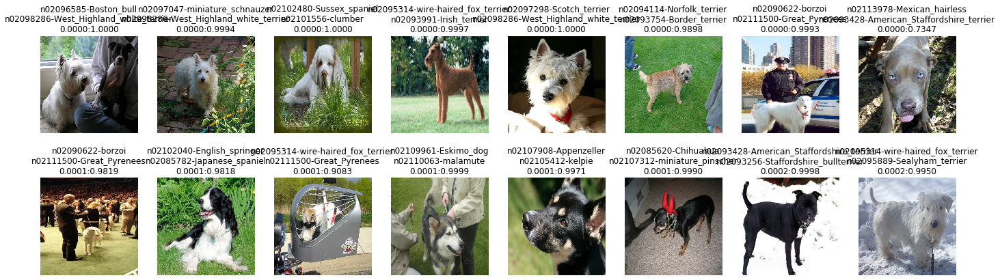

In [63]:
show_predictions(model, validation_set)

# Creating ResNet model

In [0]:
class GlobalConcatPooling2D(keras.layers.Layer):
    def __call__(self, layer: keras.layers.Layer) -> keras.layers.Layer:
        return keras.layers.concatenate(
            [
                keras.layers.GlobalAvgPool2D()(layer),
                keras.layers.GlobalMaxPool2D()(layer),
            ]
        )

In [0]:
def make_model():
    base = keras.applications.ResNet50V2(
        input_shape=IMG_DIMS, include_top=False, weights="imagenet"
    )
    x = keras.layers.GlobalMaxPool2D()(base.output)
    x = keras.layers.Dropout(0.3)(x)
    category = keras.layers.Dense(n_categories, activation=keras.activations.softmax)(x)
    bounding_box = keras.layers.Dense(4, activation=keras.activations.sigmoid)(x)
    model = keras.Model(inputs=base.input, outputs=[category, bounding_box])
    model.compile(
        loss=[
            keras.losses.SparseCategoricalCrossentropy(),
            keras.losses.BinaryCrossentropy(),
        ],
        loss_weights=[0.5, 1.0],
        optimizer=keras.optimizers.Adam(1e-4),
    )
    return model

In [53]:
model = make_model()

94674944/94668760 [==============================] - 3s 0us/step


In [54]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            [(None, 299, 299, 3) 0                                            
__________________________________________________________________________________________________
conv1_pad (ZeroPadding2D)       (None, 305, 305, 3)  0           input_1[0][0]                    
__________________________________________________________________________________________________
conv1_conv (Conv2D)             (None, 150, 150, 64) 9472        conv1_pad[0][0]                  
__________________________________________________________________________________________________
pool1_pad (ZeroPadding2D)       (None, 152, 152, 64) 0           conv1_conv[0][0]                 
______________________________________________________________________________________________

In [56]:
model.fit(
    x=train_set,
    validation_data=validation_set,
    steps_per_epoch=math.ceil(train_data.shape[0] / BATCH_SIZE),
    epochs=10,
    callbacks=[
        keras.callbacks.ModelCheckpoint(
            str(TEMP_DIR / "model_resnet.h5"), save_best_only=True, save_weights_only=True
        ),
        keras.callbacks.ReduceLROnPlateau(factor=0.3, patience=2),
        keras.callbacks.EarlyStopping(patience=3, restore_best_weights=True),
    ],
)

Train for 499 steps, validate for 63 steps
Epoch 1/10
499/499 [==============================] - 158s 316ms/step - loss: 2.5970 - dense_loss: 3.8702 - dense_1_loss: 0.6618 - val_loss: 1.3009 - val_dense_loss: 1.5833 - val_dense_1_loss: 0.5092
Epoch 2/10
499/499 [==============================] - 150s 300ms/step - loss: 1.2911 - dense_loss: 1.4955 - dense_1_loss: 0.5433 - val_loss: 1.0441 - val_dense_loss: 1.1004 - val_dense_1_loss: 0.4939
Epoch 3/10
499/499 [==============================] - 150s 301ms/step - loss: 0.9680 - dense_loss: 0.8898 - dense_1_loss: 0.5231 - val_loss: 0.9901 - val_dense_loss: 1.0217 - val_dense_1_loss: 0.4793
Epoch 4/10
499/499 [==============================] - 150s 301ms/step - loss: 0.7861 - dense_loss: 0.5633 - dense_1_loss: 0.5044 - val_loss: 0.9814 - val_dense_loss: 1.0064 - val_dense_1_loss: 0.4782
Epoch 5/10
499/499 [==============================] - 148s 297ms/step - loss: 0.6796 - dense_loss: 0.3757 - dense_1_loss: 0.4917 - val_loss: 1.0043 - val_den

In [0]:
def predict(model, dataset, n_image=0):
    for x, y in dataset.take(1):
        fig, ax = plt.subplots(1)
        ax.imshow(x[n_image].numpy())

        p_categories, p_bounding_boxes = model.predict(x)
        p_category = p_categories[n_image].argmax()
        p_bounding_box = p_bounding_boxes[n_image]
        plt.text(
            (p_bounding_box[0] + p_bounding_box[2]) * IMG_DIMS[0] - 25,
            p_bounding_box[1] * IMG_DIMS[1],
            get_category_name(p_category),
            color="white",
            backgroundcolor="blue",
            fontsize=16,
        )
        p_rect = make_rectangle(*p_bounding_box, IMG_DIMS, "b", 3)
        ax.add_patch(p_rect)

        y_categories, y_bounding_boxes = y
        y_category = y_categories[n_image].numpy()
        y_bounding_box = y_bounding_boxes[n_image].numpy()
        plt.text(
            y_bounding_box[0] * IMG_DIMS[0] + 5,
            y_bounding_box[1] * IMG_DIMS[1],
            get_category_name(y_category),
            backgroundcolor="red",
            fontsize=16,
        )
        y_rect = make_rectangle(*y_bounding_box, IMG_DIMS, "r")
        ax.add_patch(y_rect)

        plt.show()

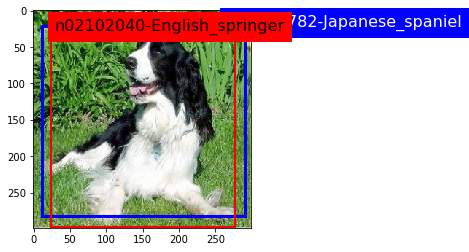

In [58]:
predict(model, validation_set, 2)

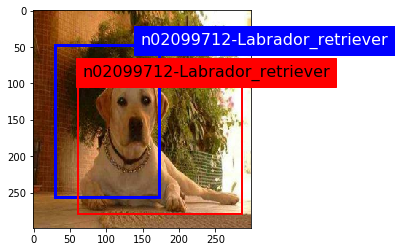

In [59]:
predict(model, validation_set, 10)

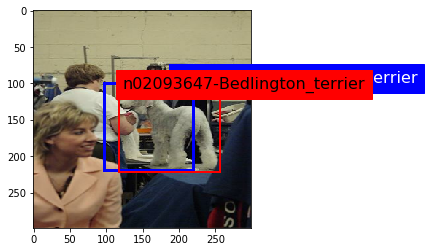

In [60]:
predict(model, validation_set, 13)

In [0]:
def show_activation_maps(model, dataset, activation_layer_name, cols: int = 4):
    activation_map_model = keras.Model(
        inputs=model.input, outputs=model.get_layer(activation_layer_name).output
    )

    images, (labels, _) = next(iter(dataset))
    activation_maps = activation_map_model.predict(images)
    class_probs, _ = model.predict(images)
    predictions = class_probs.argmax(-1)

    rows = math.ceil(len(images) / cols)

    _, ax = plt.subplots(rows, cols, figsize=(4 * cols, 4 * rows))
    for i, (image, label, activation_map, prediction) in enumerate(
        zip(images, labels, activation_maps, predictions)
    ):
        weights = model.layers[-2].get_weights()[0][:, prediction]
        class_activation_map = resize(
            activation_map.dot(weights), IMG_DIMS[:2], order=1
        )
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(image, alpha=0.8)
        ax[idx].imshow(class_activation_map, cmap="jet", alpha=0.5)

        ax[idx].set_title(get_category_name(label.numpy()))

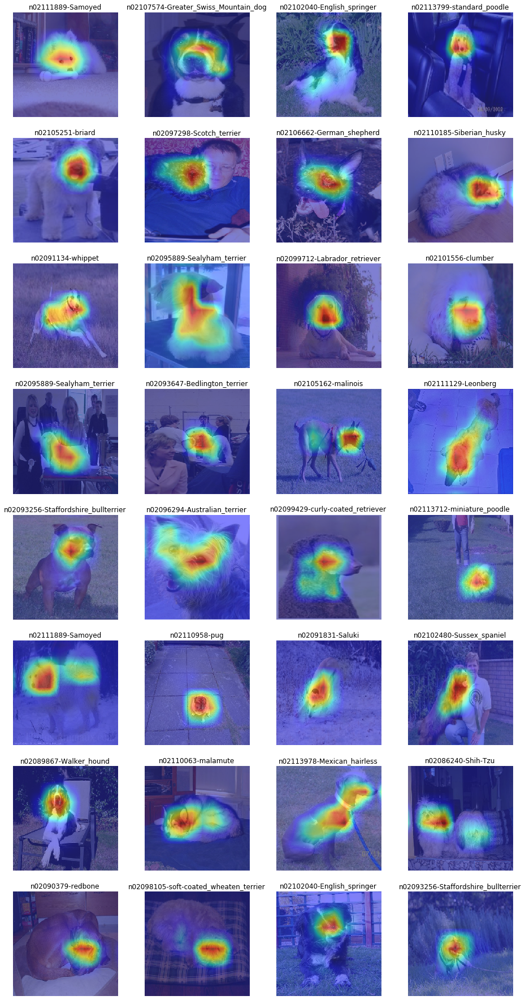

In [62]:
show_activation_maps(model, validation_set, "post_relu")

In [0]:
def make_report(model, dataset):
    print(
        classification_report(
            [category.numpy() for _, (category, _) in dataset.unbatch()],
            model.predict(dataset)[0].argmax(axis=1),
            target_names=list(category_map.values()),
        )
    )

In [64]:
make_report(model, validation_set)

                                          precision    recall  f1-score   support

                  n02091244-Ibizan_hound       0.84      0.84      0.84        19
                       n02090379-redbone       0.50      0.67      0.57        15
            n02099712-Labrador_retriever       0.64      0.82      0.72        17
                         n02115641-dingo       0.77      0.67      0.71        15
                    n02106550-Rottweiler       0.83      1.00      0.91        15
                      n02110063-malamute       0.59      0.72      0.65        18
                n02102480-Sussex_spaniel       0.88      0.93      0.90        15
             n02091032-Italian_greyhound       0.54      0.78      0.64        18
                 n02093991-Irish_terrier       0.81      0.76      0.79        17
          n02107683-Bernese_mountain_dog       0.91      0.91      0.91        22
                        n02104029-kuvasz       0.81      0.87      0.84        15
             n0

In [65]:
make_report(model, test_set)

                                          precision    recall  f1-score   support

                  n02091244-Ibizan_hound       0.71      0.89      0.79        19
                       n02090379-redbone       0.55      0.80      0.65        15
            n02099712-Labrador_retriever       0.50      0.71      0.59        17
                         n02115641-dingo       1.00      0.94      0.97        16
                    n02106550-Rottweiler       0.78      0.93      0.85        15
                      n02110063-malamute       0.67      0.67      0.67        18
                n02102480-Sussex_spaniel       0.93      0.87      0.90        15
             n02091032-Italian_greyhound       0.65      0.72      0.68        18
                 n02093991-Irish_terrier       0.69      0.65      0.67        17
          n02107683-Bernese_mountain_dog       0.80      0.91      0.85        22
                        n02104029-kuvasz       0.80      0.53      0.64        15
             n0

In [0]:
def analyse_dataset(model, dataset, verbose: int = 0):
    images = [x.numpy() for x, _ in dataset.unbatch()]
    probs = model.predict(dataset)[0]
    pred_code = probs.argmax(axis=1)
    label_code = [int(category.numpy()) for _, (category, _) in dataset.unbatch()]
    return pd.DataFrame.from_dict(
        {
            "image": images,
            "label": label_code,
            "pred": pred_code,
            "label_probs": probs[:, label_code][np.eye(len(label_code), dtype=bool)],
            "pred_probs": probs[:, pred_code][np.eye(len(pred_code), dtype=bool)],
        }
    )

In [69]:
analyse_dataset(model, validation_set)

image  ...  pred_probs
0     [[[0.42027378, 0.38497967, 0.3261561], [0.42402783, 0.3887337, 0.32991016], [0.42436704, 0.38907292, 0.33024937], [0.4279494, 0.39265528, 0.33383173], [0.42834944, 0.39305532, 0.33423176], [0.4269133, 0.39161918, 0.33279562], [0.43187097, 0.39657685, 0.3377533], [0.43187097, 0.39657685, 0.3377533], [0.42907077, 0.39377666, 0.3349531], [0.42755595, 0.38771728, 0.32256544], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43236938, 0.38923213, 0.31864387], [0.43418306, 0.3910458, 0.32045755], [0.4029497, 0.3598124, 0.28922418], [0.35355747, 0.31042022, 0.23983198], [0.325199, 0.28206176, 0.21147354], [0.32039464, 0.2755458, 0.19811118], [0.38030866, 0.30278367, 0.19574884], [0.38920555, 0.301506, 0.18093416], [0.38789722, 0.2941001, 0.17557795], [0.3863602, 0.28647864, 0.16889407], [0.39185438, 0.27833053, 0.16078432], [0.3945862, 0.27354595, 0.15270989], [0.41987538, 0.283048, 0.16625604], [0.42529935, 0.28525665, 0.16203402], [0.4164788, 0.26980656, 0.14747733], [0.40156013, 0.26054198, 0.1279679], [0.41176474, 0.27768928, 0.13532251], [0.42428195, 0.29094526, 0.15493798], [0.4425209, 0.2982446, 0.18428321], [0.4556365, 0.31053844, 0.20361425], [0.45212933, 0.30703127, 0.19758834], [0.44243407, 0.2988443, 0.18285635], [0.431042, 0.29717746, 0.16151606], [0.4125634, 0.28525668, 0.14168659], [0.39325786, 0.27568218, 0.120137535], [0.4169654, 0.2676043, 0.13414043], [0.42464995, 0.26603627, 0.13403414], [0.43341863, 0.27389994, 0.13664503], [0.44248968, 0.2738622, 0.1366073], [0.42544654, 0.26052642, 0.11214939], [0.43986118, 0.26731214, 0.11512604], [0.4311661, 0.2617483, 0.09941342], [0.4223111, 0.25368363, 0.08897775], [0.4255427, 0.25691524, 0.09119287], [0.428912, 0.25663182, 0.102615245], [0.44780982, 0.2713392, 0.14765899], [0.46075746, 0.28536892, 0.15947203], [0.46399972, 0.28401408, 0.14304088], [0.4415069, 0.26503628, 0.10463035], [0.4479648, 0.27149418, 0.107935905], [0.4516493, 0.2751787, 0.114394374], [0.4164536, 0.24390455, 0.103803545], [0.47958574, 0.30974507, 0.18789446], [0.54352164, 0.37097263, 0.27264488], [0.55848, 0.38145456, 0.27815545], [0.5451274, 0.37897226, 0.26524678], [0.483116, 0.34633243, 0.22968706], [0.5050834, 0.40058473, 0.28552145], [0.5710463, 0.48453572, 0.36279622], [0.62871295, 0.55012697, 0.42076674], [0.64067155, 0.54824775, 0.41721115], [0.6618054, 0.5396202, 0.4091068], [0.5546517, 0.40452647, 0.2650469], [0.55010825, 0.38389075, 0.24056661], [0.5424958, 0.38314912, 0.22939204], [0.5518964, 0.39895523, 0.24601403], [0.55494946, 0.39918187, 0.25471997], [0.5565876, 0.40126595, 0.26471278], [0.79609305, 0.6551723, 0.5228621], [0.8042499, 0.678563, 0.5580239], [0.7903348, 0.68072116, 0.5677039], [0.613927, 0.5214162, 0.41096953], [0.57375807, 0.50516343, 0.3934315], [0.5826325, 0.5232319, 0.42127115], [0.56625354, 0.50980395, 0.408617], [0.5864385, 0.50980395, 0.40661684], [0.5512492, 0.4519181, 0.33863848], [0.5194571, 0.40000004, 0.26530918], [0.5329408, 0.39343, 0.25142068], [0.5442394, 0.38800615, 0.24110466], [0.56524366, 0.40053782, 0.2515182], [0.57520497, 0.4104991, 0.26147947], [0.5643911, 0.39968523, 0.2469276], [0.5780575, 0.40275428, 0.24138628], [0.5808054, 0.40895808, 0.2667915], [0.63965684, 0.48661074, 0.37079343], [0.86536825, 0.7339826, 0.6268017], [0.8391107, 0.73396945, 0.607102], [0.8473556, 0.75723827, 0.60221815], [0.80740494, 0.7328951, 0.5696189], [0.8854238, 0.8075629, 0.66745543], [0.55284196, 0.46842325, 0.36131477], [0.49253735, 0.41332558, 0.32310995], [0.49171087, 0.41960788, 0.3416814], [0.48201188, 0.41142365, 0.33299226], [0.47450984, 0.4039216, 0.3254902], [0.47450984, 0.4039216, 0.3254902], ...], [[0.42883056, 0.39353645, 0.3347129], [0.43044138, 0.39514726, 0.3363237], [0.43311042, 0.3978163, 0.33899274], [0.4348905, 0.3995964, 0.34077284], [0.43818614, 0.40289202, 0.34406847], [0.43540555, 0.40011144, 0.34128788], [0.43883708, 0.40354297, 0.3447194], [0.43

In [0]:
def show_predictions(
    model,
    dataset,
    correct: bool = False,
    ascending: bool = True,
    cols: int = 8,
    rows: int = 2,
):
    df = analyse_dataset(model, dataset)
    df = df[(df.label == df.pred) if correct else (df.label != df.pred)]
    df.sort_values(by=["label_probs"], ascending=ascending, inplace=True)
    _, ax = plt.subplots(rows, cols, figsize=(3 * cols, 3.5 * rows))
    for i, row in enumerate(df.head(cols * rows).itertuples()):
        idx = (i // cols, i % cols) if rows > 1 else i % cols
        ax[idx].axis("off")
        ax[idx].imshow(row.image)
        ax[idx].set_title(
            f"{get_category_name(row.label)}\n{get_category_name(row.pred)}\n{row.label_probs:.4f}:{row.pred_probs:.4f}"
        )

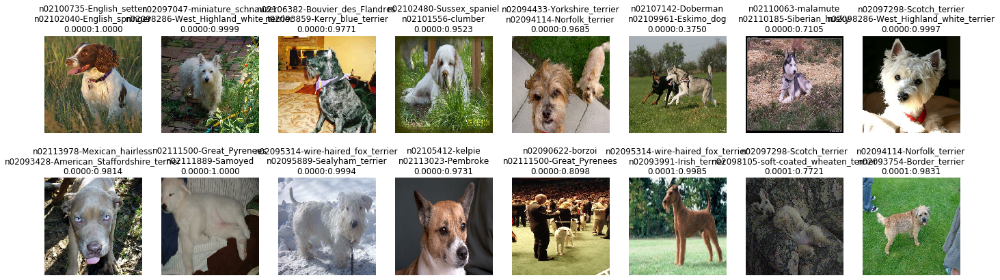

In [71]:
show_predictions(model, validation_set)